In [56]:
import yfinance as yf


msi_data = yf.download("MSI", start="2020-01-01", end="2024-01-01")
print(msi_data.head())


[*********************100%***********************]  1 of 1 completed

                  Open        High         Low       Close   Adj Close  \
Date                                                                     
2020-01-02  162.169998  162.309998  160.770004  161.630005  151.500626   
2020-01-03  160.029999  164.580002  159.369995  164.380005  154.078293   
2020-01-06  163.929993  167.029999  163.110001  166.919998  156.459106   
2020-01-07  165.880005  166.449997  165.000000  165.720001  155.334305   
2020-01-08  165.899994  166.899994  165.039993  165.889999  155.493637   

             Volume  
Date                 
2020-01-02  1356900  
2020-01-03   962400  
2020-01-06  1544400  
2020-01-07  1131000  
2020-01-08  1386800  


In [58]:
#  daily returns
msi_data['Returns'] = msi_data['Adj Close'].pct_change()


In [60]:
# annualized volatility
volatility = msi_data['Returns'].std() * (252**0.5)  # Assuming 252 trading days in a year
print(f"Annualized Volatility: {volatility:.2f}")


Annualized Volatility: 0.30


In [62]:
import numpy as np

# Value at Risk (VaR)
confidence_level = 0.05
var_95 = np.percentile(msi_data['Returns'].dropna(), confidence_level * 100)
print(f"95% VaR: {var_95:.2%}")


95% VaR: -2.76%


In [64]:
# Expected Shortfall (CVaR)
expected_shortfall = msi_data['Returns'][msi_data['Returns'] <= var_95].mean()
print(f"Expected Shortfall (ES): {expected_shortfall:.2%}")


Expected Shortfall (ES): -4.39%


In [66]:
#  market data (e.g., S&P 500 index as a proxy for the market)
sp500_data = yf.download("^GSPC", start="2020-01-01", end="2023-01-01")
sp500_data['Returns'] = sp500_data['Adj Close'].pct_change()

# Merge with Motorola Solutions data
combined_data = msi_data[['Returns']].merge(sp500_data[['Returns']], how='inner', left_index=True, right_index=True, suffixes=('_MSI', '_SP500'))

# beta
cov_matrix = combined_data.cov()
beta = cov_matrix.iloc[0, 1] / cov_matrix.iloc[1, 1]
print(f"Beta: {beta:.2f}")


[*********************100%***********************]  1 of 1 completed

Beta: 0.95


In [68]:
# Parameters for the Monte Carlo Simulation
num_simulations = 1000   # Number of simulations
num_days = 252           # Number of days to simulate (1 year)
initial_price = msi_data['Adj Close'].iloc[-1]   # Last observed price as the initial price

# mean and volatility from historical data
mean_return = msi_data['Returns'].mean()
volatility = msi_data['Returns'].std()


In [70]:
#  an empty matrix to hold simulation results
simulation_results = np.zeros((num_simulations, num_days))

for i in range(num_simulations):
    # Generate daily returns using a random normal distribution
    daily_returns = np.random.normal(mean_return, volatility, num_days)
    
    # Price path array
    price_path = np.zeros(num_days)
    price_path[0] = initial_price
    
    # Simulate the price over time
    for t in range(1, num_days):
        price_path[t] = price_path[t-1] * (1 + daily_returns[t])
    
    # Store the simulated price path
    simulation_results[i, :] = price_path


In [72]:
import matplotlib.pyplot as plt

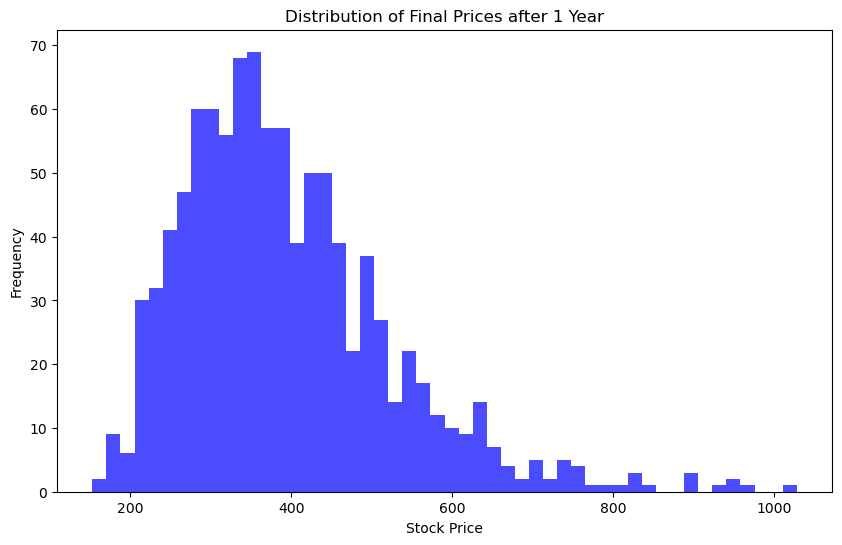

Mean Final Price: 392.85
5th Percentile (VaR): 226.09
95th Percentile: 633.18


In [74]:
# Get the final prices from all simulations
final_prices = simulation_results[:, -1]

# Plot the distribution of final prices
plt.figure(figsize=(10,6))
plt.hist(final_prices, bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Final Prices after 1 Year')
plt.xlabel('Stock Price')
plt.ylabel('Frequency')
plt.show()

# Calculating statistics
mean_final_price = np.mean(final_prices)
percentile_5 = np.percentile(final_prices, 5)
percentile_95 = np.percentile(final_prices, 95)

print(f"Mean Final Price: {mean_final_price:.2f}")
print(f"5th Percentile (VaR): {percentile_5:.2f}")
print(f"95th Percentile: {percentile_95:.2f}")


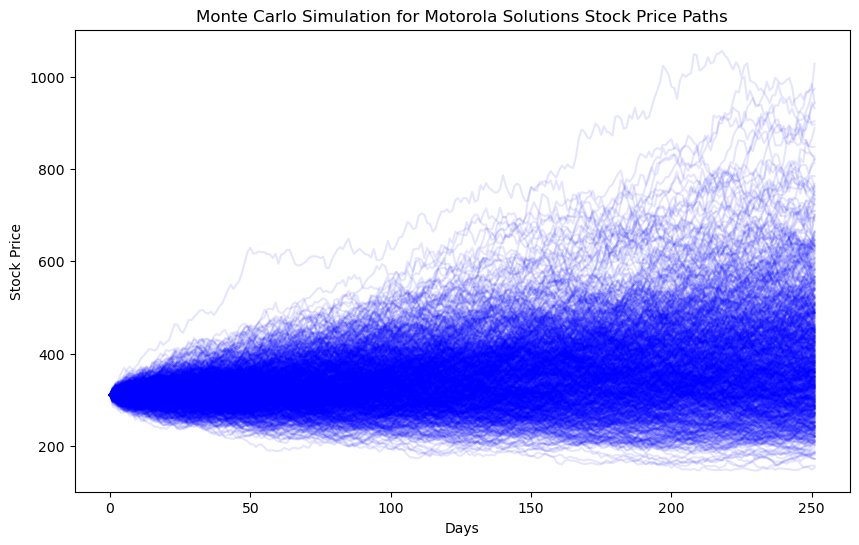

In [76]:
# Plotting multiple simulation price paths
plt.figure(figsize=(10,6))
plt.plot(simulation_results.T, alpha=0.1, color='blue')  # Transpose to plot all paths
plt.title(f"Monte Carlo Simulation for Motorola Solutions Stock Price Paths")
plt.xlabel('Days')
plt.ylabel('Stock Price')
plt.show()


In [34]:
# Assuming a risk-free rate of 0.02 (2%)
risk_free_rate = 0.02

# Calculating daily returns from simulation results
simulated_daily_returns = (simulation_results[:, 1:] / simulation_results[:, :-1]) - 1

# Mean and standard deviation of simulated returns
mean_simulated_return = np.mean(simulated_daily_returns)
std_simulated_return = np.std(simulated_daily_returns)

#  Sharpe Ratio
sharpe_ratio = (mean_simulated_return - risk_free_rate) / std_simulated_return
print(f"Sharpe Ratio: {sharpe_ratio:.2f}")


Sharpe Ratio: -1.01


In [36]:
# Conditional Value at Risk (CVaR) calculation
cvar_5 = final_prices[final_prices <= percentile_5].mean()
print(f"Conditional Value at Risk (CVaR): {cvar_5:.2f}")


Conditional Value at Risk (CVaR): 201.98


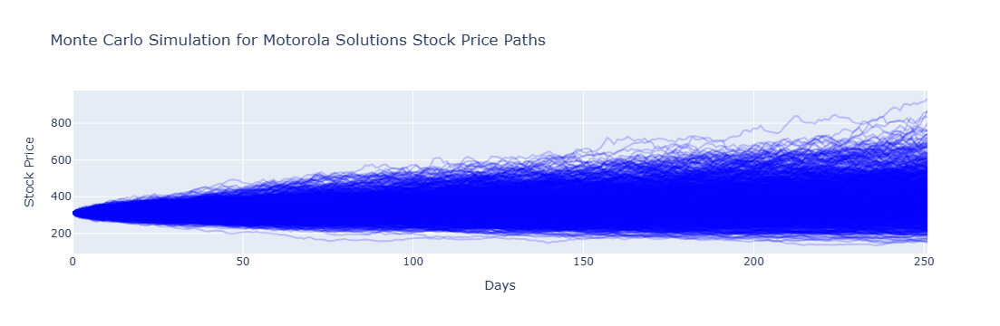

In [38]:
import plotly.graph_objs as go

# interactive plot
fig = go.Figure()

#  price paths to the plot
for i in range(num_simulations):
    fig.add_trace(go.Scatter(
        x=list(range(num_days)),
        y=simulation_results[i],
        mode='lines',
        opacity=0.2,
        line=dict(color='blue'),
        showlegend=False
    ))

#  titles and labels
fig.update_layout(
    title='Monte Carlo Simulation for Motorola Solutions Stock Price Paths',
    xaxis_title='Days',
    yaxis_title='Stock Price'
)

fig.show()


Annualized Volatility:

Result: 30%
Explanation: This measures the variability in Motorola Solutions' stock returns on an annual basis. A volatility of 30% means the stock price tends to fluctuate by about 30% annually, indicating moderate risk.
95% Value at Risk (VaR):

Result: -2.76%
Explanation: This means that, with 95% confidence, the stock is not expected to lose more than 2.76% on any given day. VaR quantifies the potential downside risk.
Expected Shortfall (ES) (also known as Conditional VaR):

Result: -4.39%
Explanation: Expected Shortfall represents the average loss beyond the 95% VaR threshold. If the stock experiences a loss worse than the 95% VaR, the average loss would be around 4.39%.
These results indicate moderate risk for Motorola Solutions, with relatively stable returns, but potential daily losses of up to 2.76% in extreme cases. The expected shortfall shows the possible magnitude of losses in worst-case scenarios